In [4]:
import cv2
import numpy as np
import argparse
import imutils
import cv2
import matplotlib.pyplot as plt
from PIL import Image
import glob,os
import os
import distutils.dir_util
image_list = []


In [7]:
ls

 Volume in drive C is OS
 Volume Serial Number is C03D-204D

 Directory of C:\datasets

30-06-2018  14:59    <DIR>          .
30-06-2018  14:59    <DIR>          ..
30-06-2018  14:27    <DIR>          .ipynb_checkpoints
26-06-2018  21:55    <DIR>          Bend
22-06-2018  08:39         1,661,234 CIFAR.ipynb
30-06-2018  14:59        56,238,411 crop_2.ipynb
20-06-2018  11:30            36,135 final_crop.ipynb
26-06-2018  22:30    <DIR>          Handshake
26-06-2018  22:14    <DIR>          Hand-wave
26-06-2018  22:42    <DIR>          Jump
26-06-2018  22:42    <DIR>          Jump in place
26-06-2018  22:42    <DIR>          models
28-06-2018  09:37         4,177,439 opti.ipynb
28-06-2018  17:42         5,420,150 opti_final.ipynb
30-06-2018  14:30        76,067,025 preprocess_15 frames.ipynb
26-06-2018  22:46    <DIR>          Pull
26-06-2018  23:01    <DIR>          Run
30-06-2018  14:30            50,345 Temporal_CNN.ipynb
30-06-2018  14:29               555 Untitled.ipynb
26-06-2018  2

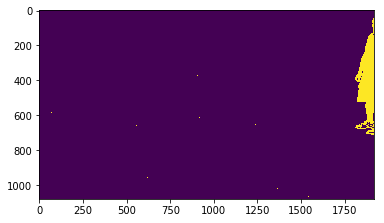

0


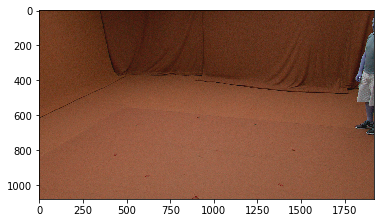

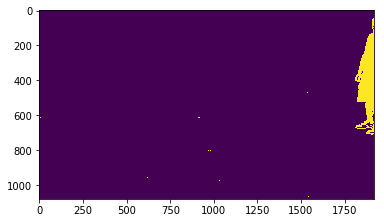

1


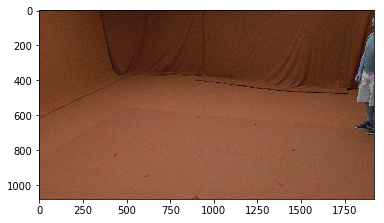

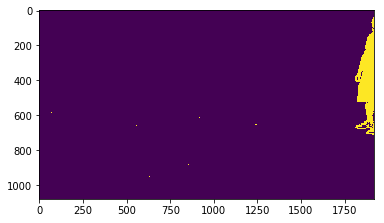

2


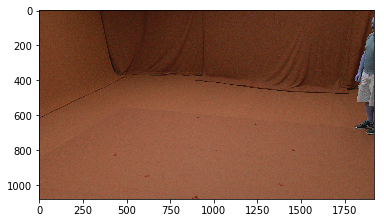

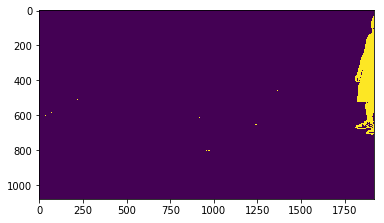

3


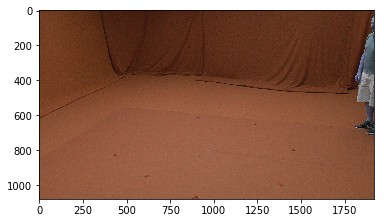

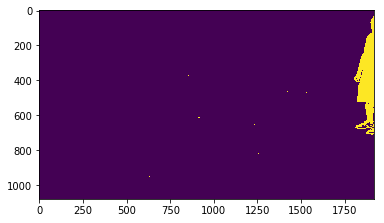

4


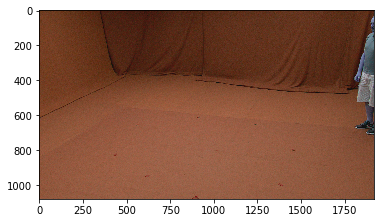

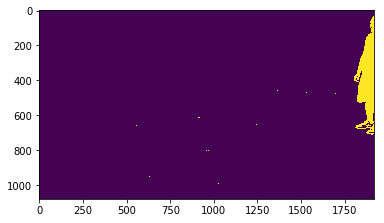

5


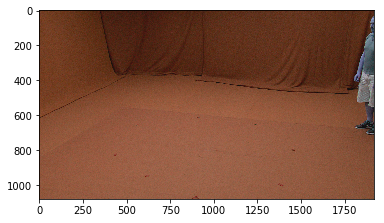

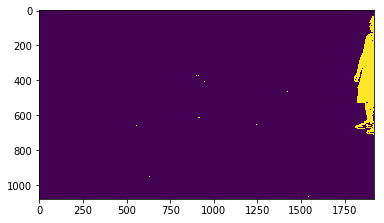

6


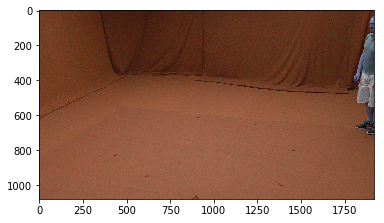

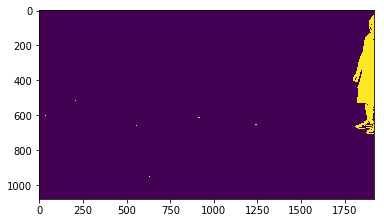

7


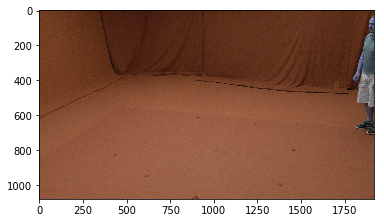

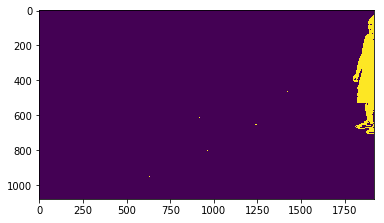

8


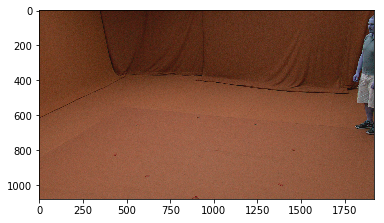

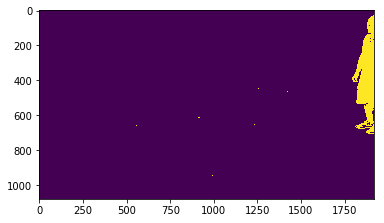

9


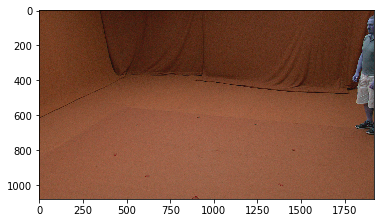

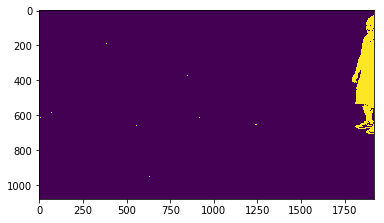

10


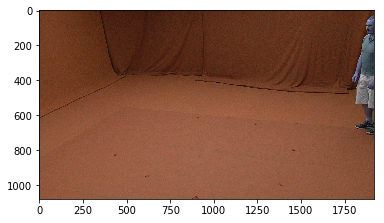

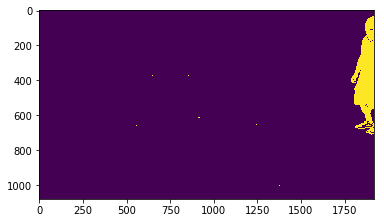

11


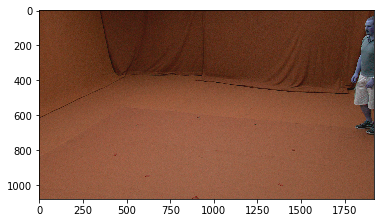

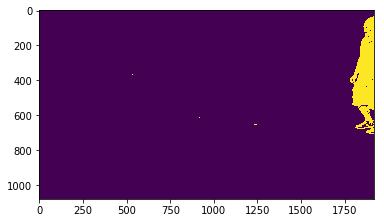

12


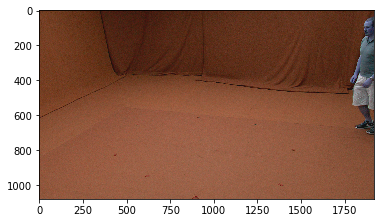

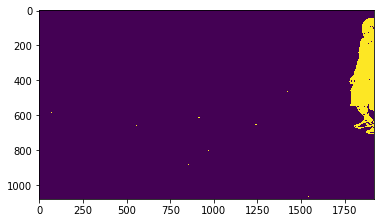

13


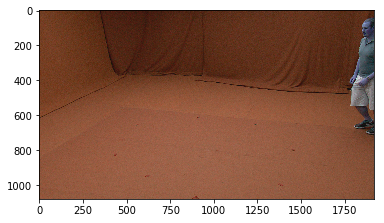

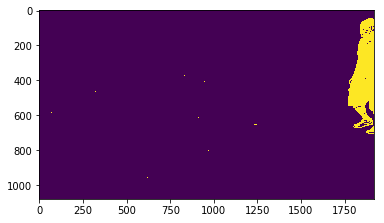

14


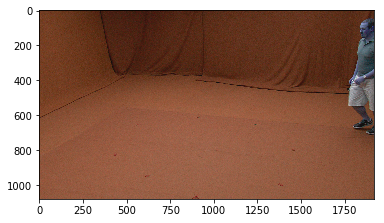

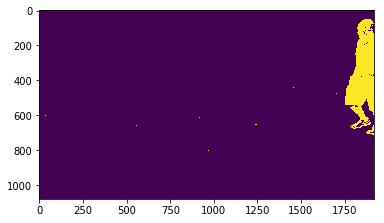

15


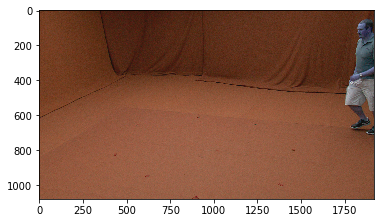

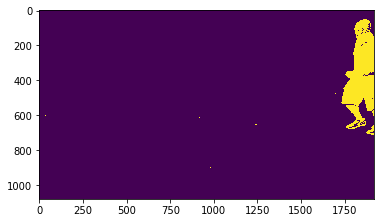

16


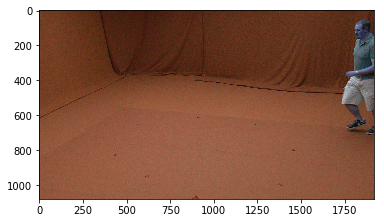

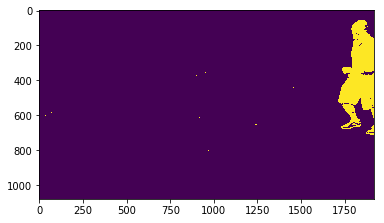

17


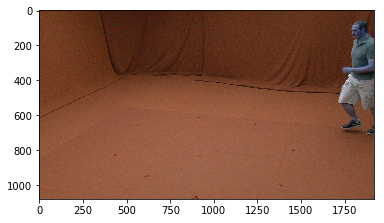

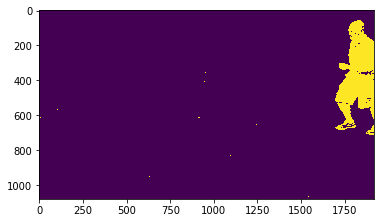

18


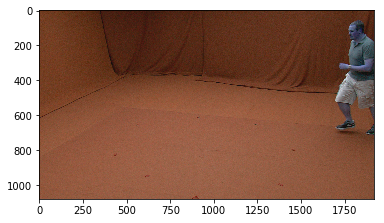

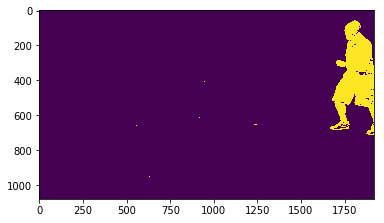

19


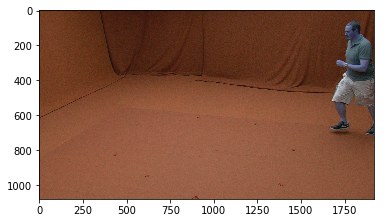

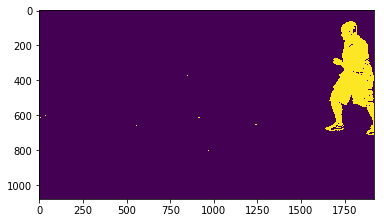

20


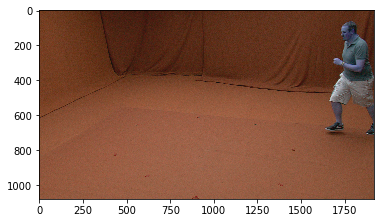

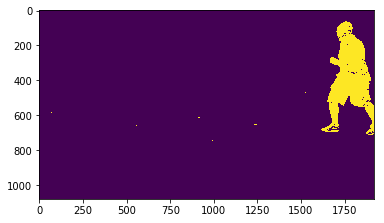

21


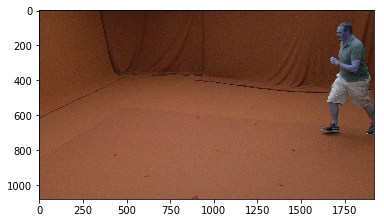

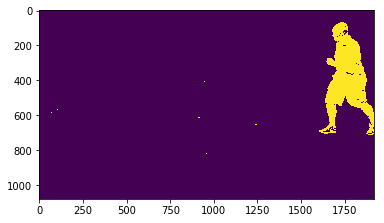

22


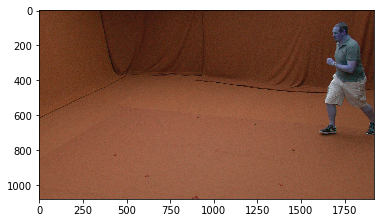

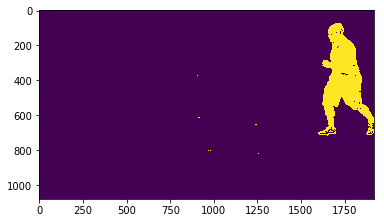

23


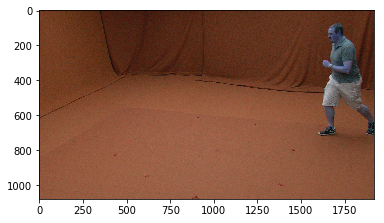

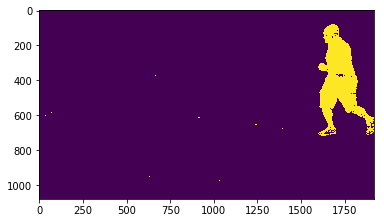

24


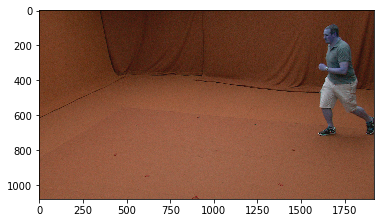

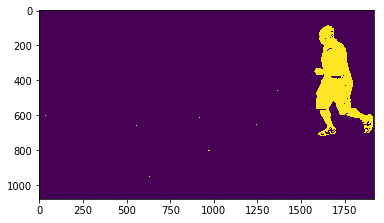

25


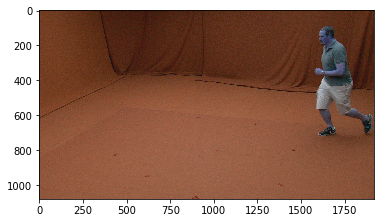

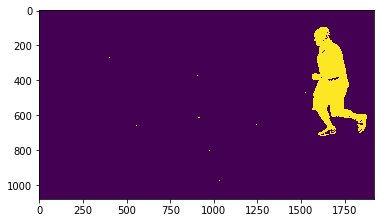

26


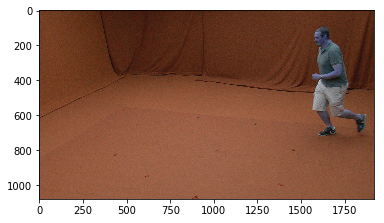

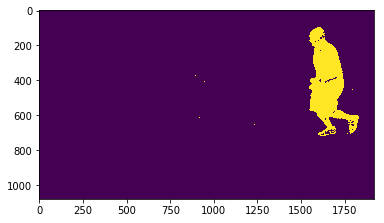

27


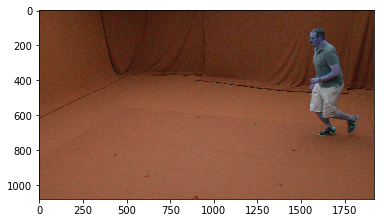

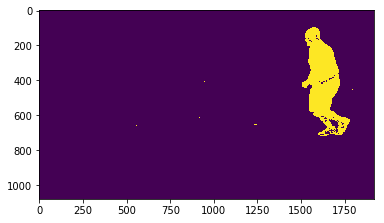

28


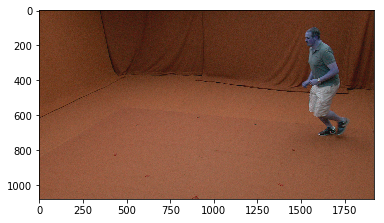

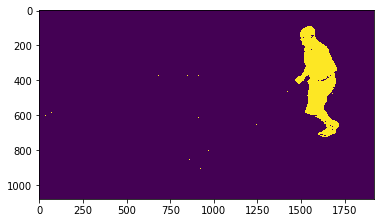

29


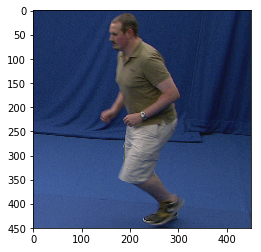

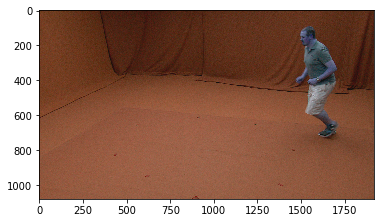

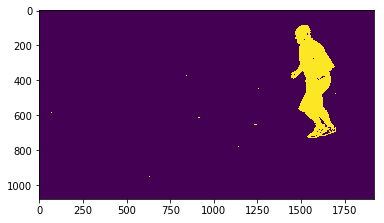

30


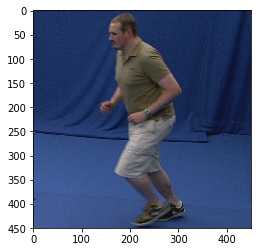

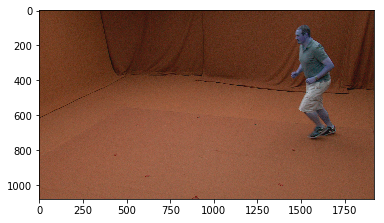

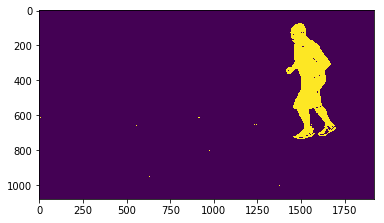

31


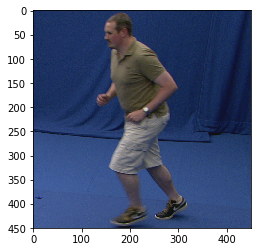

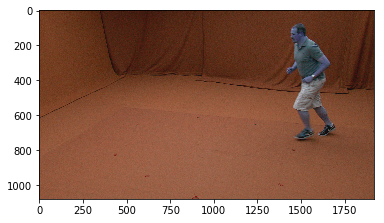

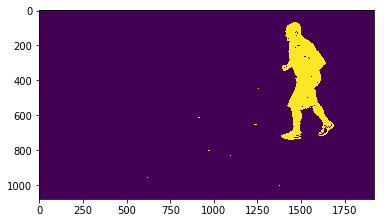

32


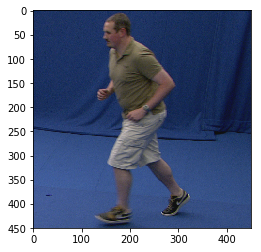

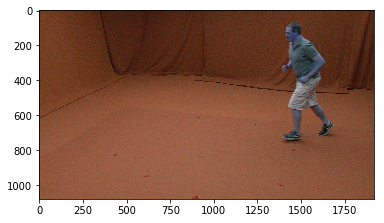

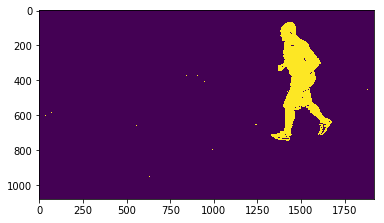

33


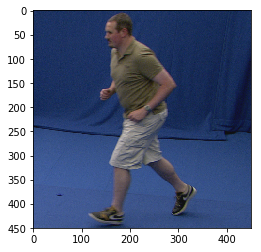

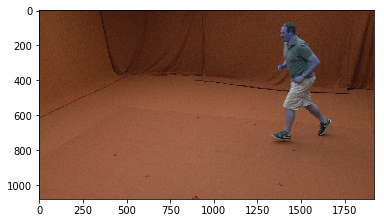

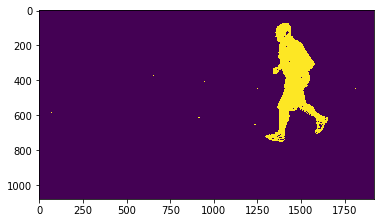

34


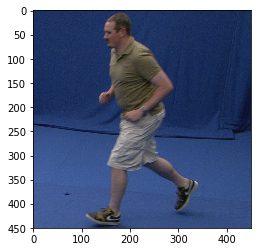

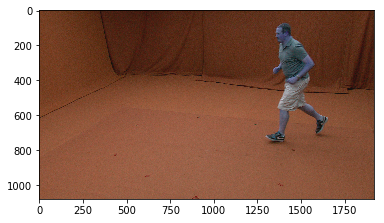

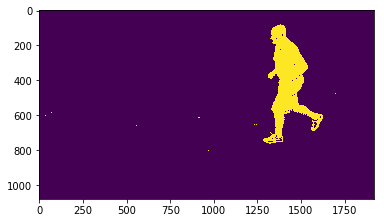

35


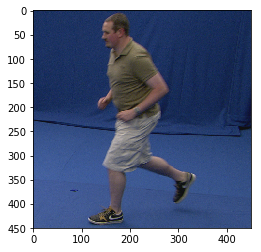

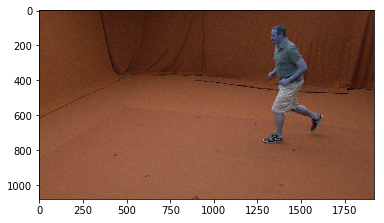

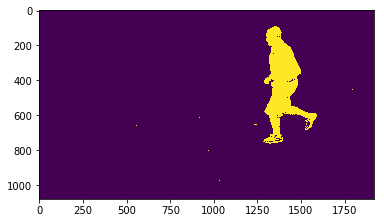

36


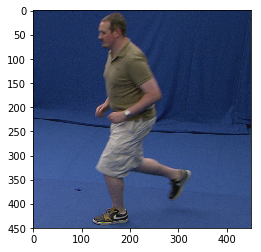

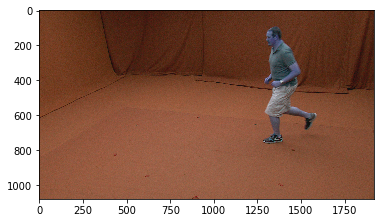

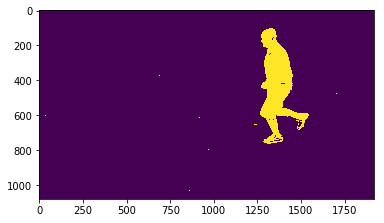

37


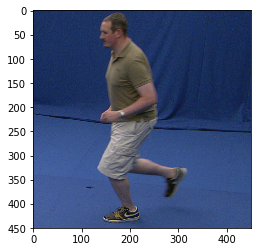

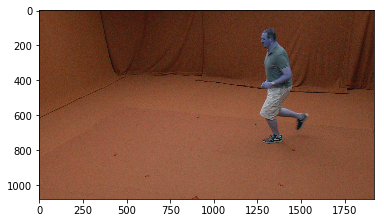

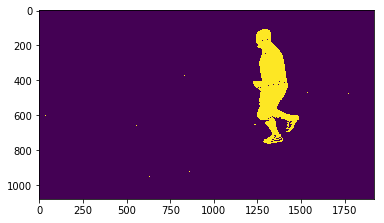

38


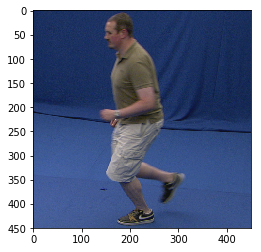

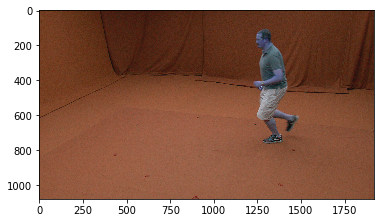

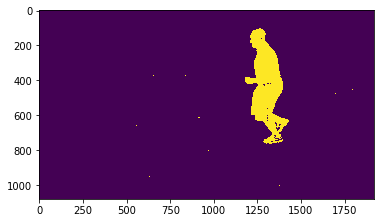

39


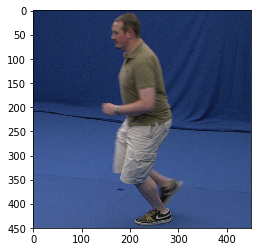

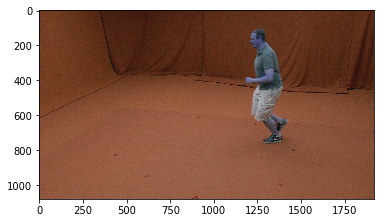

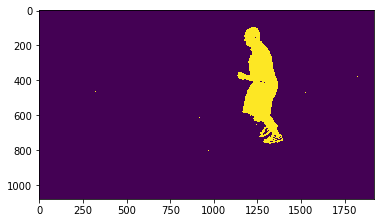

40


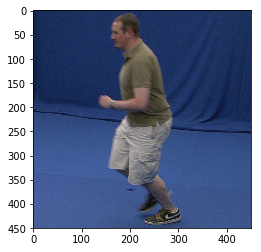

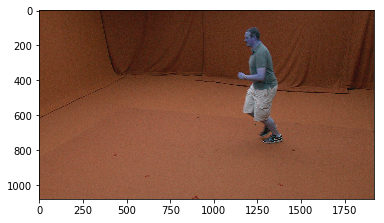

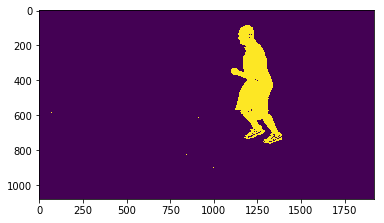

41


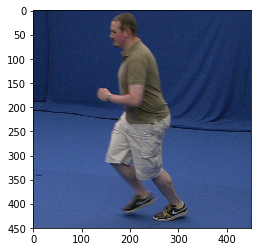

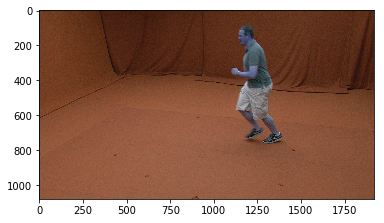

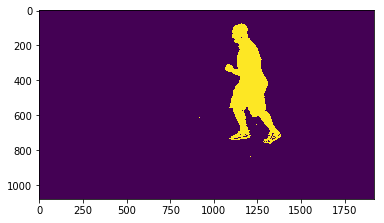

42


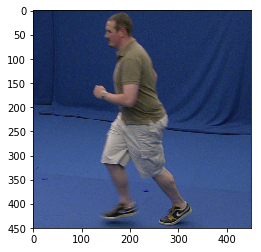

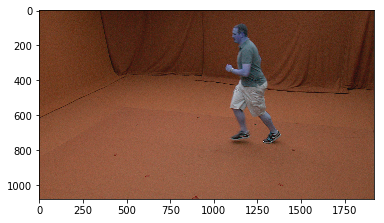

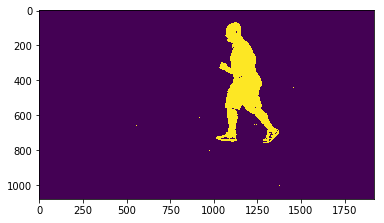

43


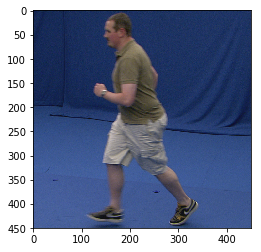

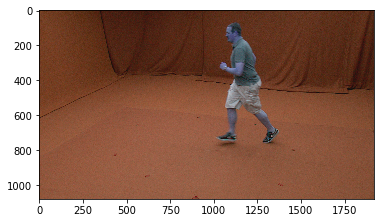

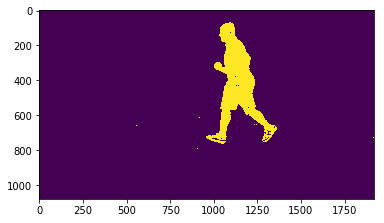

44


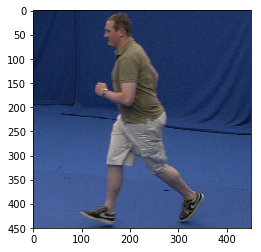

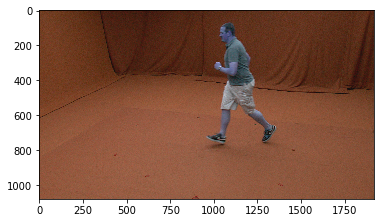

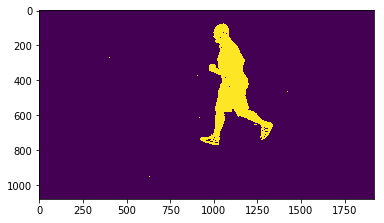

45


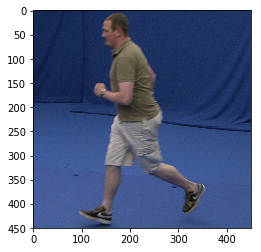

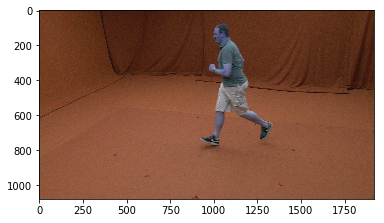

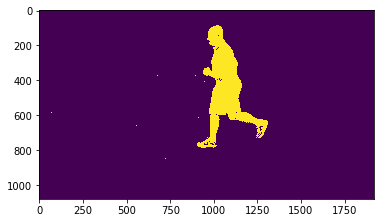

46


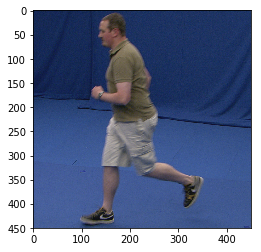

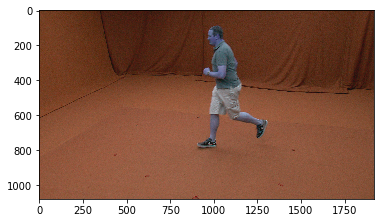

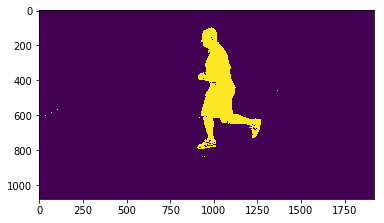

47


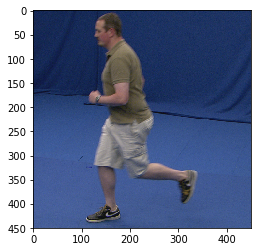

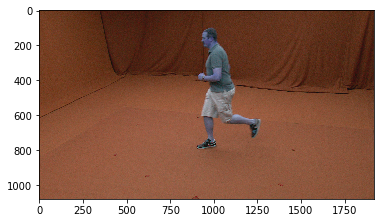

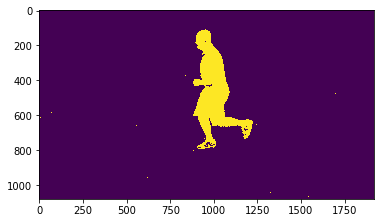

48


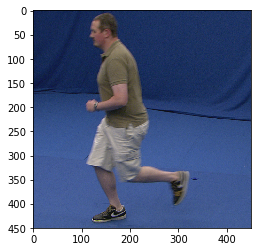

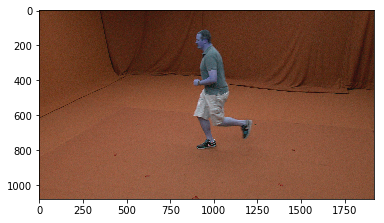

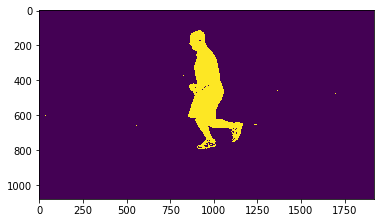

49


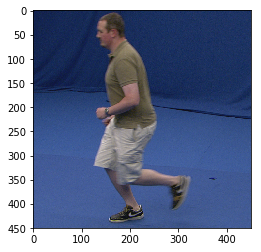

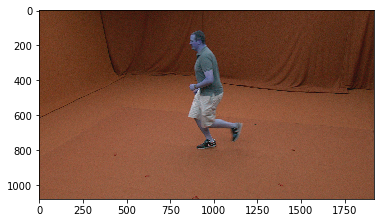

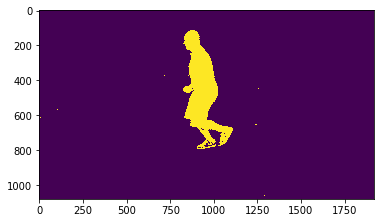

50


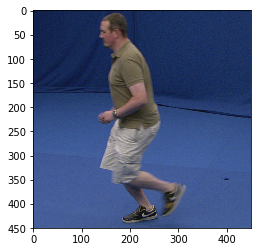

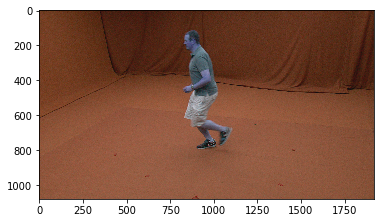

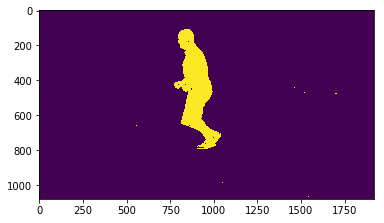

51


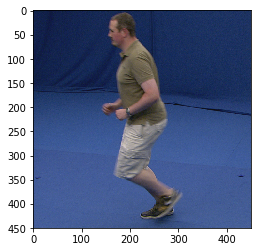

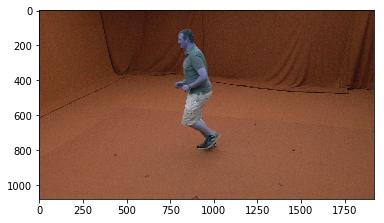

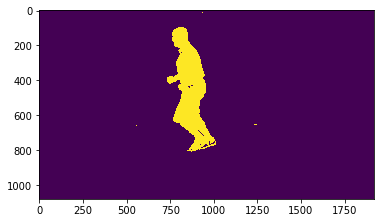

52


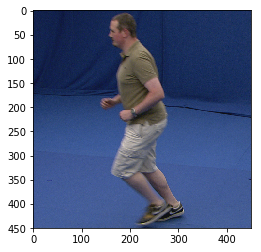

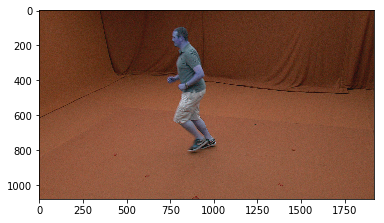

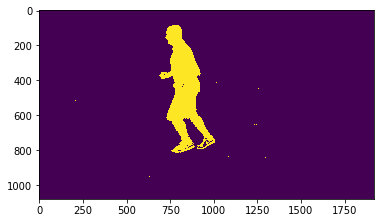

53


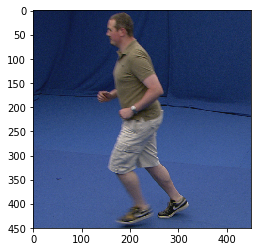

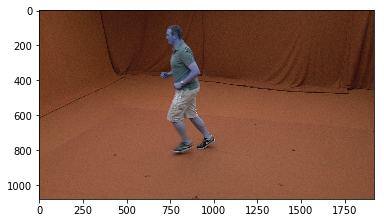

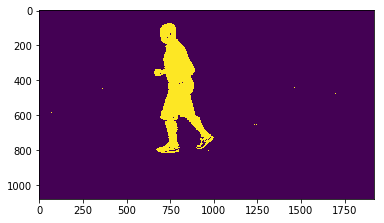

54


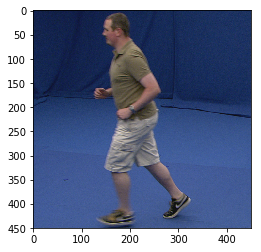

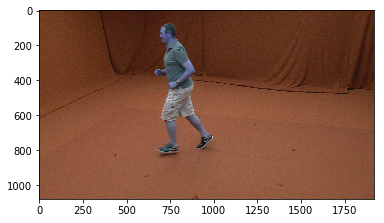

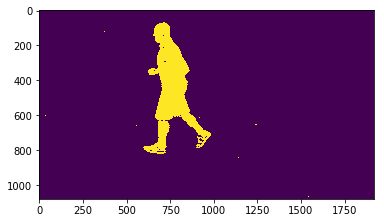

55


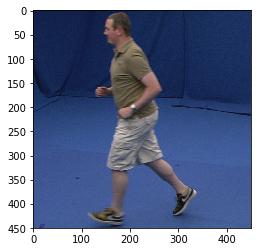

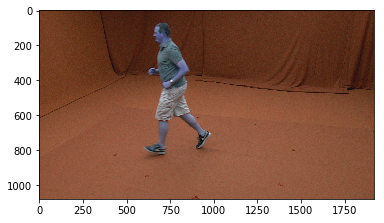

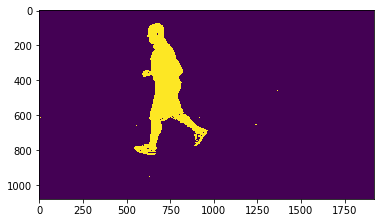

56


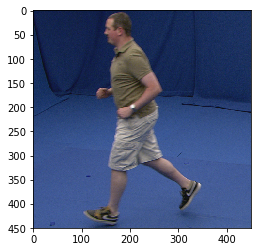

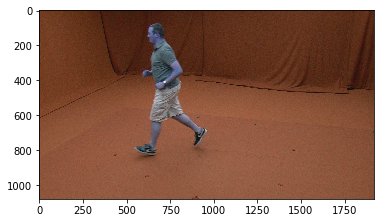

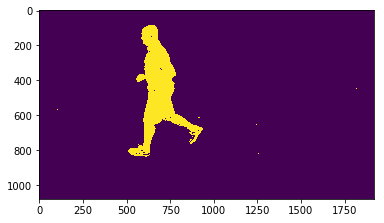

57


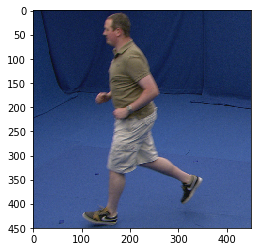

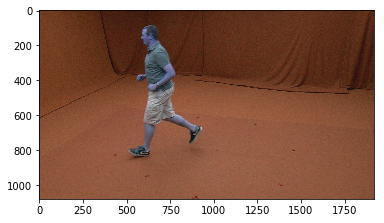

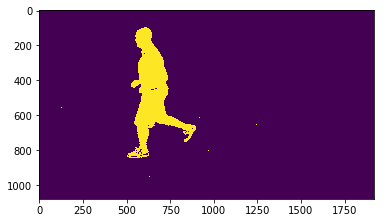

58


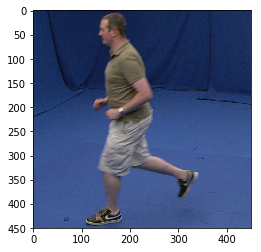

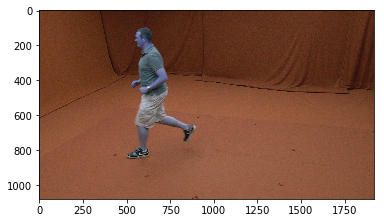

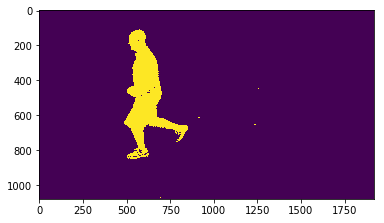

59


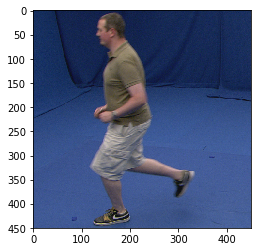

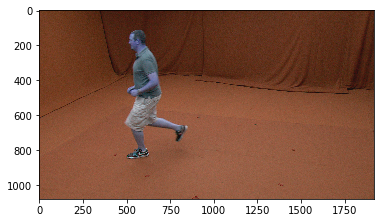

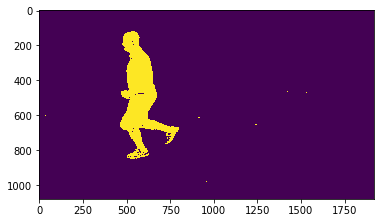

60


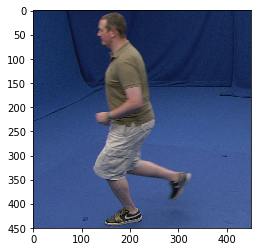

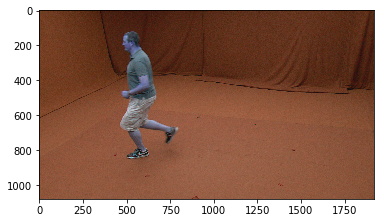

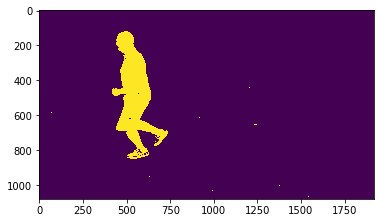

61


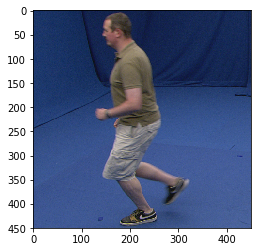

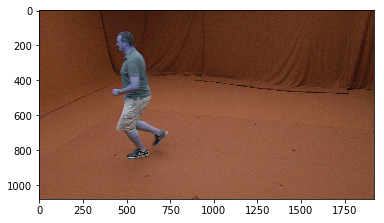

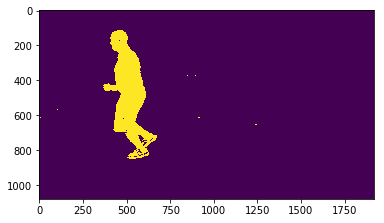

62


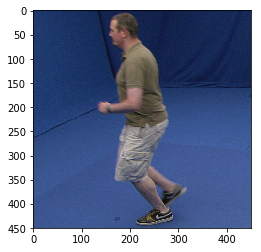

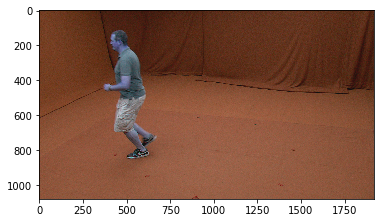

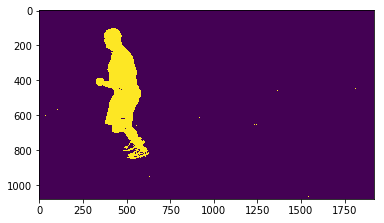

63


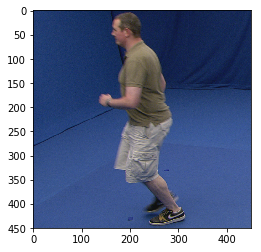

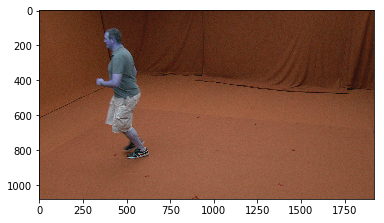

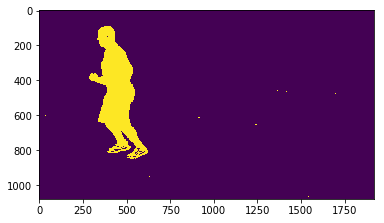

64


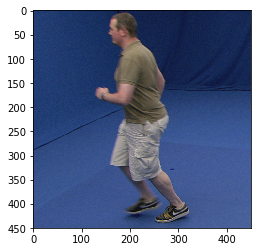

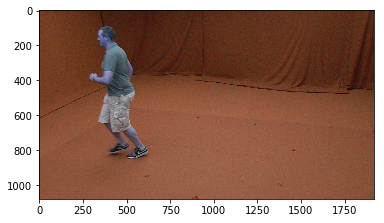

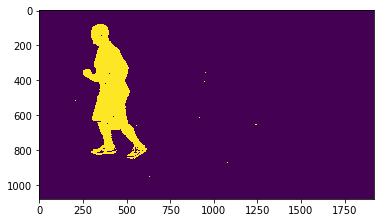

65


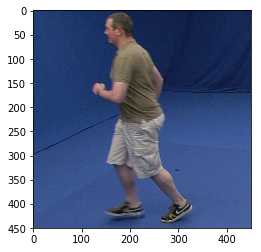

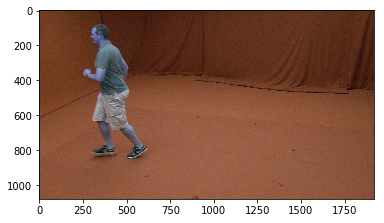

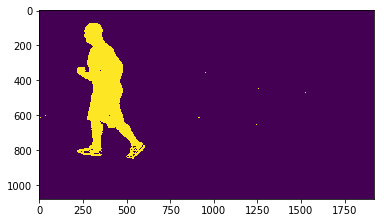

66


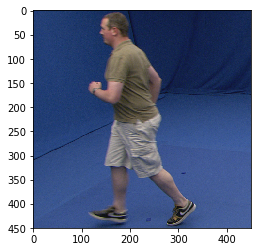

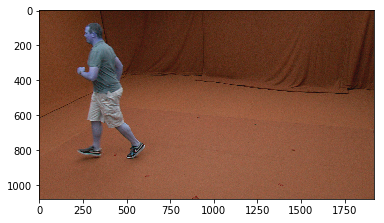

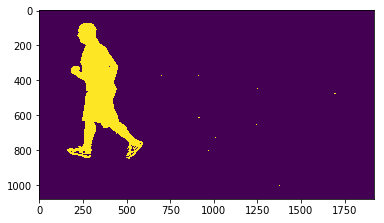

67


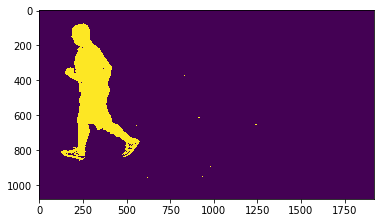

68


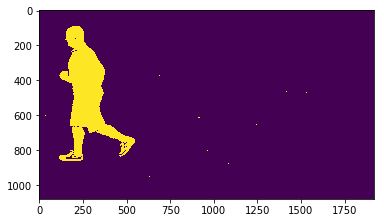

69


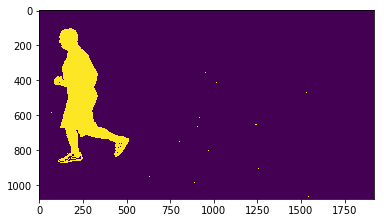

70


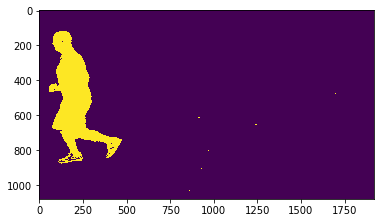

71


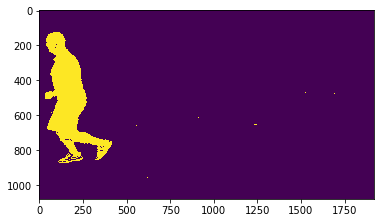

72


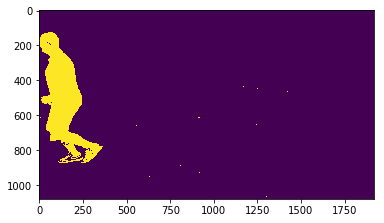

73


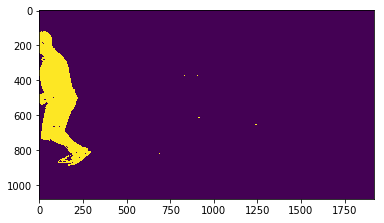

74


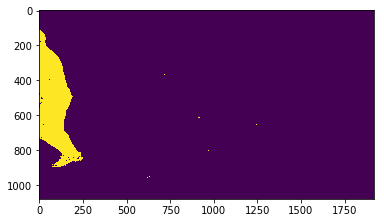

75


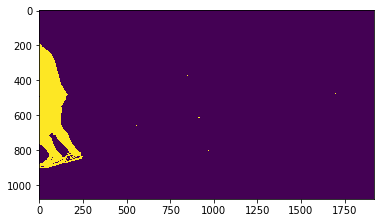

76


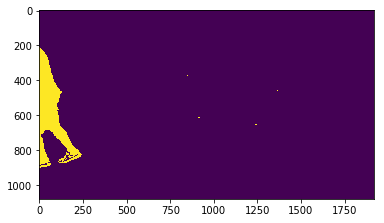

77


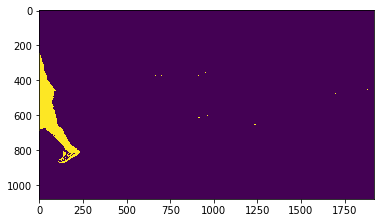

78


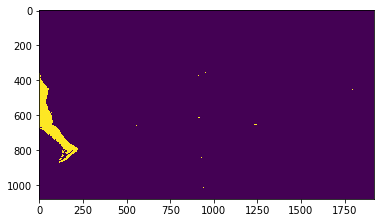

79


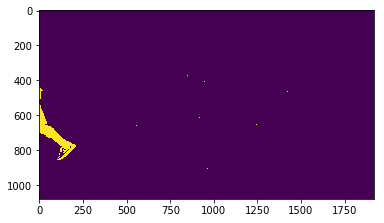

80


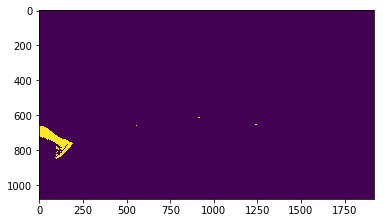

81


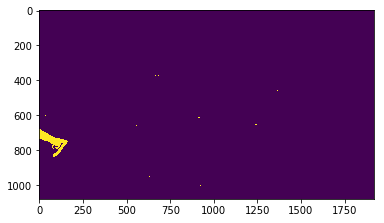

82


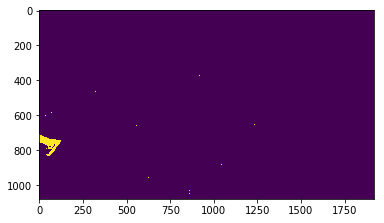

83


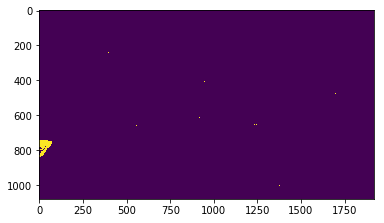

84


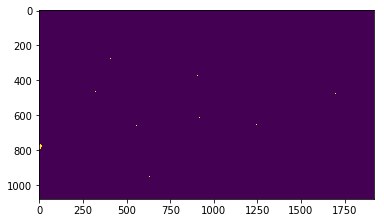

85


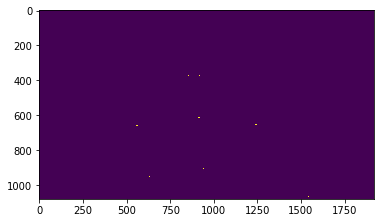

86


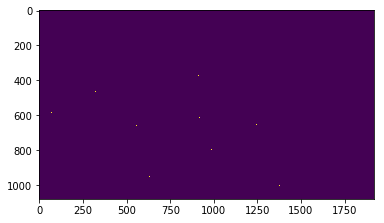

87


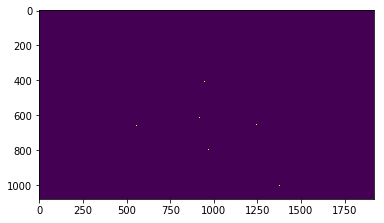

88


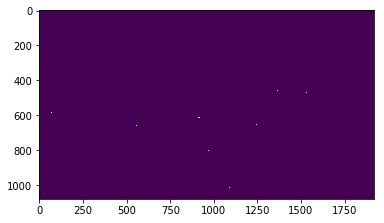

89


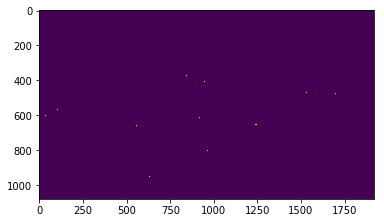

90


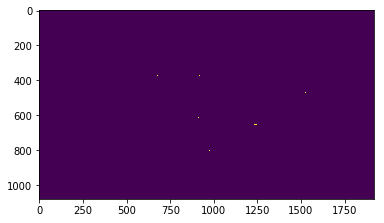

91


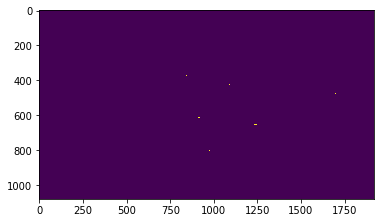

92


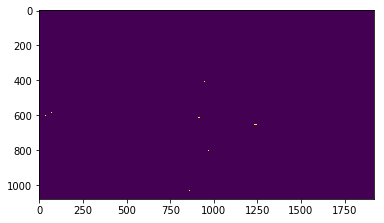

93


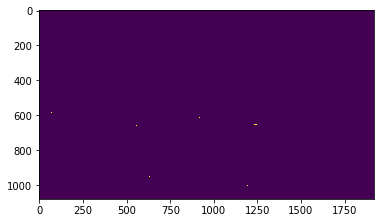

94


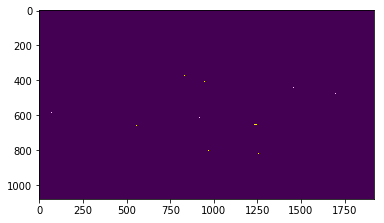

95


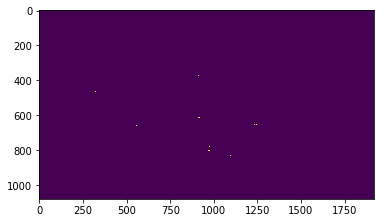

96


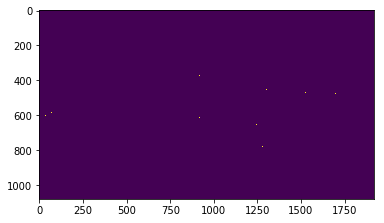

97


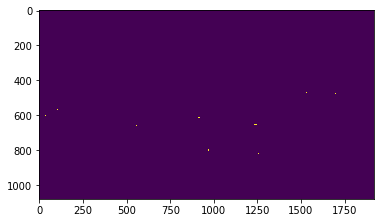

98


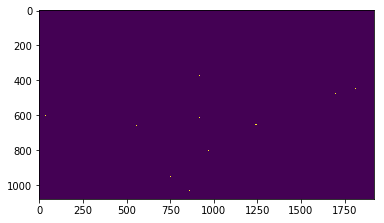

99


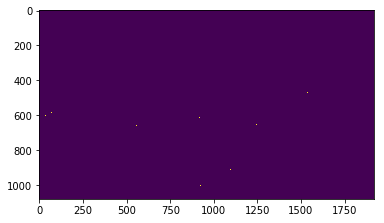

100


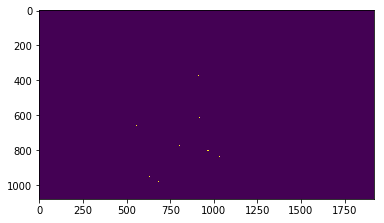

101


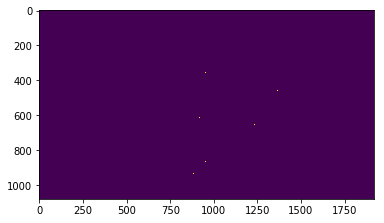

102


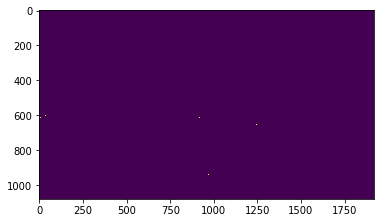

103


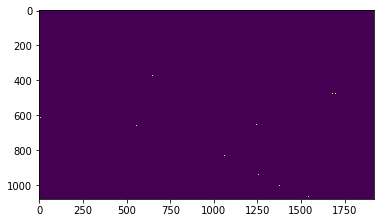

104


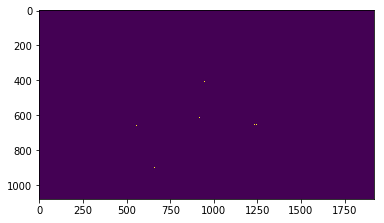

105


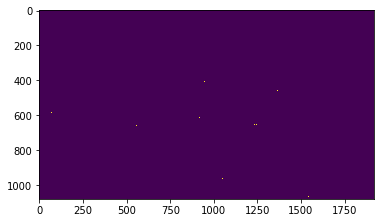

106


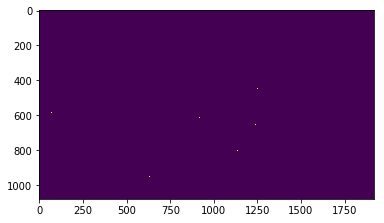

107


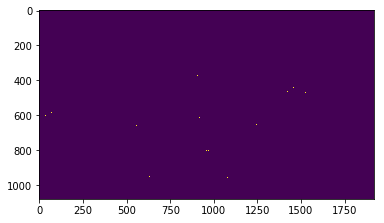

108


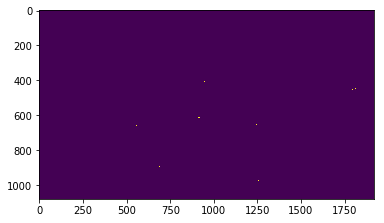

109


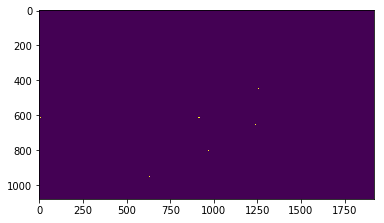

110


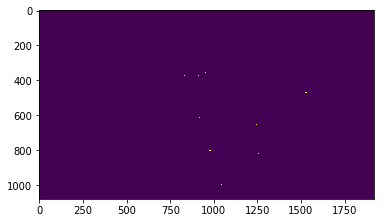

111


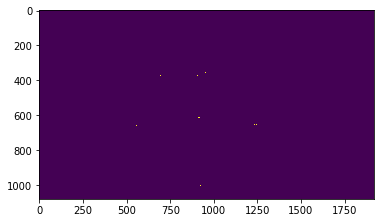

112


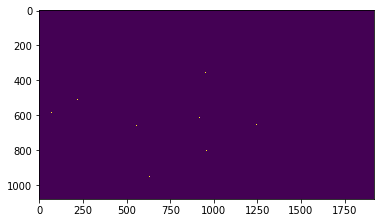

113


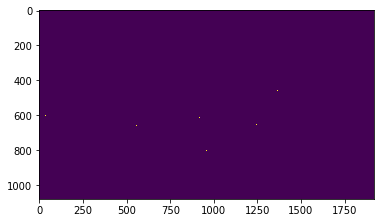

114


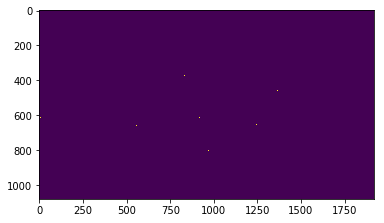

115


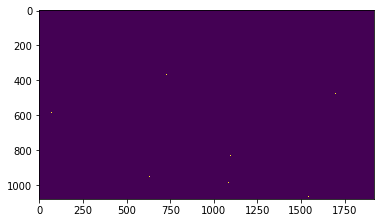

116


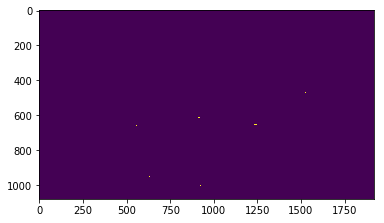

117


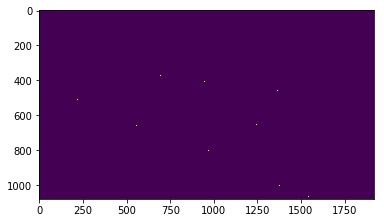

118


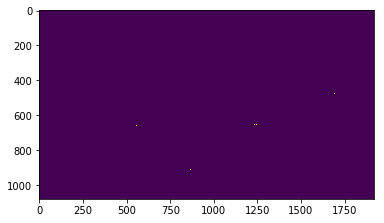

119


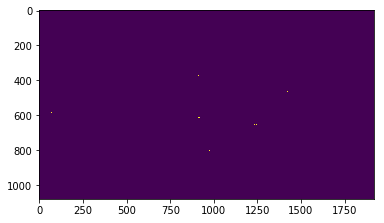

120


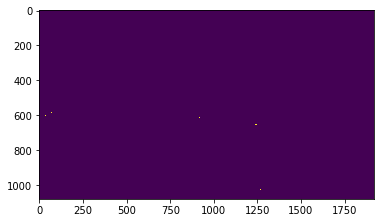

121


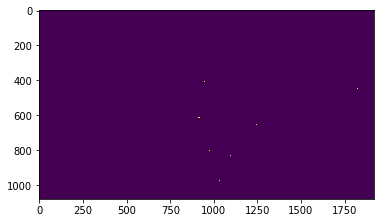

122


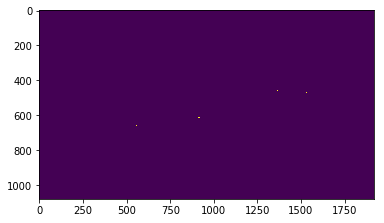

123


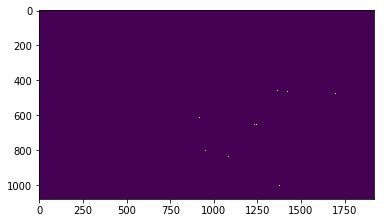

124


In [18]:
path = "F:\dataset(cleaned)"
#'Run\Man3\D1-042.tar\D1-042\Jon\GR-jon\\042\\000\\*.png'
# 'Bend\Man5\D2-044.tar\D2-044\Hansung\GR-Hansung\044\004\\*.png'
for i in range(1,2):
    image_list = []
    file = r'''Run\Man6\D2-030.tar\D2-030\Joe\GR-Joe\030\00''' +str(i)+'''\\*.png'''
    file1 = os.path.split(file)[0]
    fname = os.path.split(file1)[1]
    f_path = os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(file1))))))
    #distutils.dir_util.mkpath(path+"/"+f_path+"/"+fname)
    mypath = path+"/"+f_path+"/"+fname
    if not os.path.isdir(mypath):
        os.makedirs(mypath)
    dir_path = path+"/"+f_path+"/"+fname
    for filename in glob.glob(file): 
        #print(filename)
        #im=Image.open(filename)
        image_list.append(filename)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(6,6))
    for i in  range(0,len(image_list)):
    
        frame = image_list[i]
        frame = cv2.imread(frame)
        hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
        #lower_green = np.array([0,53,50])
        #upper_green = np.array([255,215, 210])  
        lower_green = np.array([70,113,40])
        upper_green = np.array([255, 255, 255])
        #lower_green = np.array([20,0,50])
        #upper_green = np.array([255,205, 200])    #lower_green = np.array([70,103,40]) #upper_green = np.array([255,255, 255])
        mask = cv2.inRange(hsv, lower_green, upper_green)
        fg = cv2.bitwise_and(frame, frame, mask=255-mask)

        fg = cv2.cvtColor(fg.copy(),cv2.COLOR_HSV2BGR)
        fg = cv2.cvtColor(fg,cv2.COLOR_BGR2GRAY)
        #fg = cv2.morphologyEx(fg.copy(), cv2.MORPH_CLOSE, kernel)
        #fg = cv2.morphologyEx(fg, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (24,24)))
        se = np.ones((3,3),np.uint8)
        ##fg = cv2.dilate(fg, kernel = se , iterations = 3)
        fg = cv2.threshold(fg, 20, 255, cv2.THRESH_BINARY)[1]
    
        plt.imshow(fg)
        plt.show()
    
        """fgclosing = cv2.morphologyEx(fg.copy(), cv2.MORPH_CLOSE, kernel)
        #fgclosing = cv2.morphologyEx(fg.copy(), cv2.MORPH_CLOSE, kernel)
        se = np.ones((3,3),np.uint8)
        #fgdilated = cv2.morphologyEx(fgclosing, cv2.MORPH_CLOSE, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (4,4)))
        fgdilated = cv2.dilate(fgclosing, kernel = se , iterations = 10)
        fgdilated = cv2.morphologyEx(fgdilated.copy(), cv2.MORPH_CLOSE, kernel)
        fgdilated = cv2.morphologyEx(fgdilated.copy(), cv2.MORPH_OPEN, kernel)"""
    
    
     
        img = frame.copy()
        ret, threshed_img = cv2.threshold(fg,
                        0, 255, cv2.THRESH_BINARY)
        threshed_img = cv2.dilate(threshed_img, kernel = se , iterations = 8)
        image, contours, hier = cv2.findContours(threshed_img, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
        print(i)
        #plt.imshow(fgdilated)
        #plt.show()
        for cnt in contours:
            #print(cv2.contourArea(cnt))
            if cv2.contourArea(cnt) > 30000:
                # get convex hull
                hull = cv2.convexHull(cnt)
                #cv2.drawContours(img, [hull], -1, (0, 0, 255), 1)
                #print(hull)
                (x,y,w,h) = cv2.boundingRect(cnt)
                #cv2.rectangle(img, (x,y), (x+w,y+h), (255, 0, 0), 2)
                contours = hull
                #c1 = max(contours, key=cv2.contourArea)
                hull = cv2.convexHull(cnt)
                c = hull
                #print(c)
                cv2.drawContours(img, [hull], -1, (0, 0, 255), 1)
                # determine the most extreme points along the contour
                extLeft = tuple(c[c[:, :, 0].argmin()][0])
                extRight = tuple(c[c[:, :, 0].argmax()][0])
                extTop = tuple(c[c[:, :, 1].argmin()][0])
                extBot = tuple(c[c[:, :, 1].argmax()][0])
    
                cv2.drawContours(img, [c], -1, (0, 255, 255), 2)
                cv2.circle(img, extLeft, 8, (0, 0, 255), -1)
                cv2.circle(img, extRight, 8, (0, 255, 0), -1)
                cv2.circle(img, extTop, 8, (255, 0, 0), -1)
                cv2.circle(img, extBot, 8, (255, 255, 0), -1)
            
                lx = extLeft[1]
                ly = extLeft[0]
                rx = extRight[1]
                ry = extRight[0]
                tx = extTop[1]
                ty = extTop[0]
                bx = extBot[1]
                by = extBot[0]
            
                #print('lx:',lx)
                #print('ly:',ly)
                #print('rx:',rx)
                #print('ry:',ry)
                #print('tx:',tx)
                #print('ty:',ty)
                #print('bx:',bx)
                #print('by:',by)
            
                x,y = lx,by
                w,h = abs(rx-lx),abs(ty-by)
                #print('y:',y,', y+h:',y+h)
                #print('x:',x,', x+w:',x+w)
                #print(x,x+w)
                #cv2.rectangle(img, (x,y), (x+w,y+h), (255, 0, 0), 2)
                font = cv2.FONT_HERSHEY_SIMPLEX
                cv2.putText(img,str(extLeft[0])+','+str(extLeft[1]),(extLeft), font, 2,(0, 0, 255),2,cv2.LINE_AA)
                cv2.putText(img,str(extRight[0])+','+str(extRight[1]),(extRight), font, 2,(0, 255, 0),2,cv2.LINE_AA)
                cv2.putText(img,str(extTop[0])+','+str(extTop[1]),(extTop), font, 2,(255, 0, 0),2,cv2.LINE_AA)
                cv2.putText(img,str(extBot[0])+','+str(extBot[1]),(extBot), font, 2,(255, 255, 0),2,cv2.LINE_AA)
               
                #print(img.shape)

                #im = frame[30:150,100:150,:]
                #im = frame[y:y+h,x:x+w]
                #print(im.shape)
            
                #plt.imshow(img)
                #plt.show()

                fy,fx,_ = frame.shape

                #print(extLeft,extRight,extTop,extBot)
                #print(frame.shape)
                #print(str(tx)+':'+str(bx)+','+str(ly)+':'+str(ry)+',:')
                #print(im.shape)
                im = frame[tx:bx,ly:ry,:]
                cx = int(im.shape[1]//2)
                cy = int(im.shape[0]//2)
                #print(cx,cy)
                cfx,cfy = int(ly+cx),int(tx+cy)
                #print(lx,ty)
                #cv2.circle(im, (cx,cy), 15, (0, 255, 0))
                wdt = int(cfx -cy)
                extremeX = int(cfx + cy)
                #print("yr:",wdt,extremeX)
                #cv2.circle(frame, (ly+cx,tx+cy), 8, (255, 0, 255), -1)
                """if i ==0:
                    tx1 = tx
                    bx1 = bx
                    wdt1 = wdt
                    extremeX1 = extremeX
                    print(tx,':',bx,',',wdt,':',extremeX)
                    #tx: 82 , bx: 801  wdt: 601  extremeX: 1319
                crop  = frame[tx1 : bx1 , wdt1 : extremeX1]
                crop = cv2.cvtColor(crop, cv2.COLOR_BGR2RGB)
                cv2.imwrite(os.path.join(dir_path , str(i)+'.png'), cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
                cv2.waitKey(0)
                plt.imshow(crop)
                plt.show()"""
                #tx: 60 , bx: 850  wdt: 599  extremeX: 1389
                crop = frame[tx:bx,wdt:extremeX,:]
                #print(crop.shape)  
                img_track = frame.copy()
                if extremeX and wdt in range(0,fx): 
                    #cv2.circle(img_track, (ly+cx,tx+cy), 15, (255, 0, 255), -1)
                    crop = frame[tx:bx,wdt:extremeX,:]
                    #print(crop.shape)
                    if -40 <= crop.shape[0] - crop.shape[1] <= 40 :
                        crop = cv2.resize(crop, (450, 450))
                        crop = cv2.cvtColor(crop, cv2.COLOR_BGR2RGB)
                    
                        plt.imshow(crop)
                        plt.show()
                        #crop.save(os.path.join(path , str(i)+'.png', 'PNG'))

                        cv2.imwrite(os.path.join(dir_path , str(i)+'.png'), cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
                        cv2.waitKey(0)
                    plt.imshow(img_track)
                    plt.show()
                
                #cv2.circle(frame, (1306,580), 8, (255, 0, 255), -1) # (cfx,cfy)
                #cv2.circle(frame, (1741,580), 8, (255, 0, 255), -1) # (cfx+cy,cfy)
                #cv2.circle(frame,(871,580), 8, (255, 0, 255), -1)   # (cy*2,cfy )

                #plt.imshow(im)
                #plt.show()
                #plt.imshow(frame)
                #plt.show()

        #plt.imshow(img)
        #plt.show()


0
33 : 1079 , 1337 : 2383


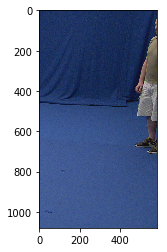

1


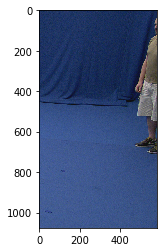

2


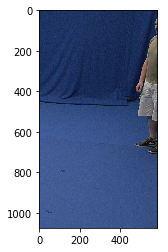

3


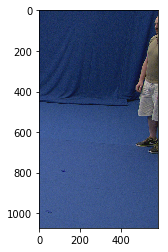

4


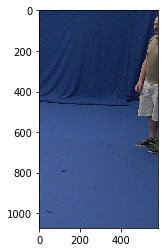

5


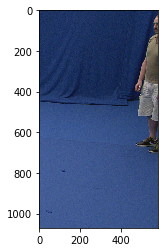

6


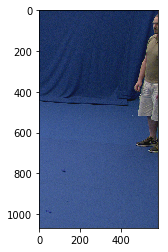

7


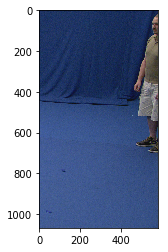

8


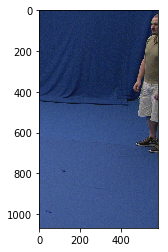

9


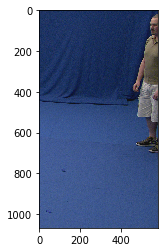

10


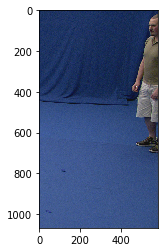

11


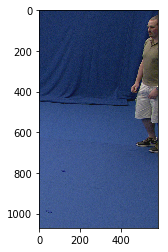

12


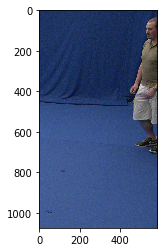

13


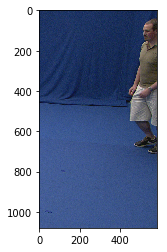

14


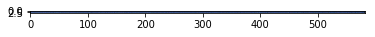

15


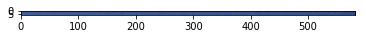

16


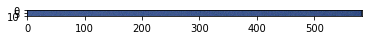

17


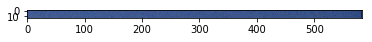

18


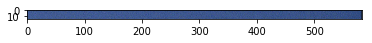

19


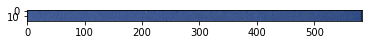

20


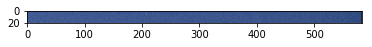

21


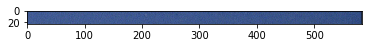

22


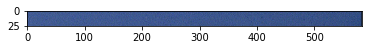

23


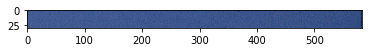

24


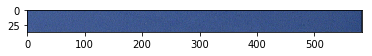

25


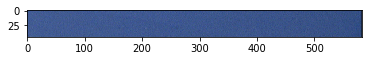

26


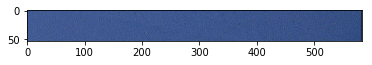

27


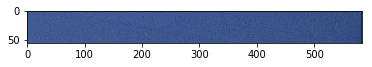

28


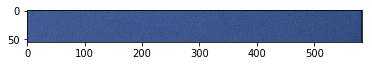

29


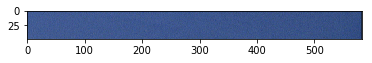

30


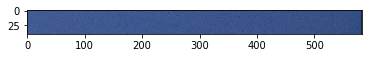

31


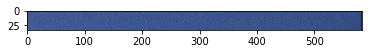

32


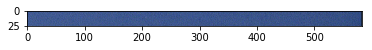

33


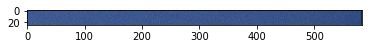

34


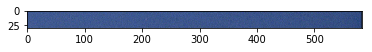

35


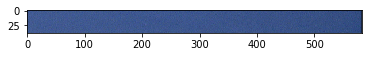

36


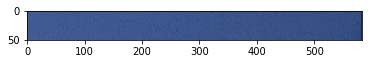

37


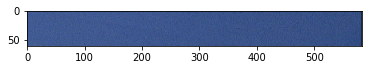

38


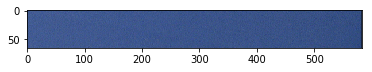

39


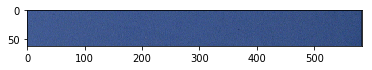

40


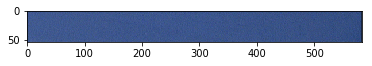

41


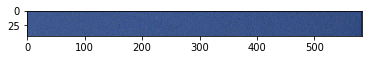

42


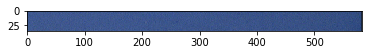

43


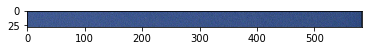

44


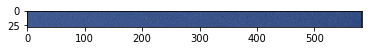

45


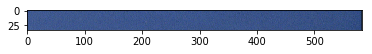

46


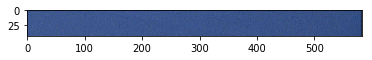

47


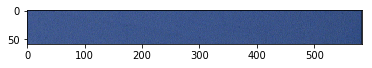

48


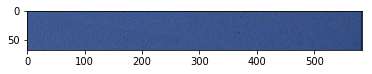

49


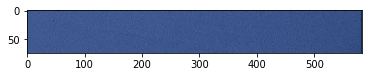

50


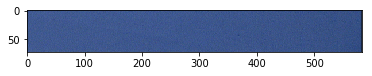

51


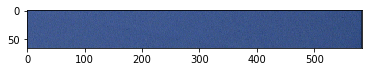

52


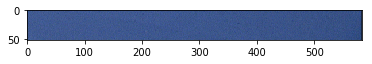

53


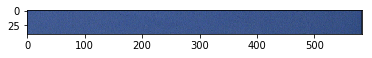

54


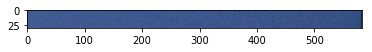

55


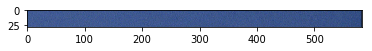

56


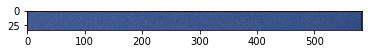

57


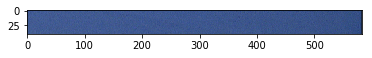

58


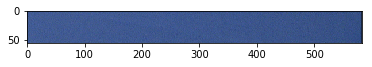

59


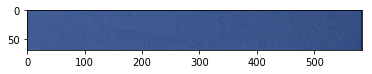

60


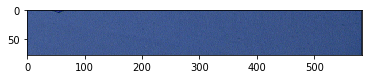

61


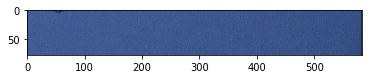

62


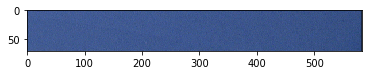

63


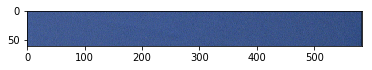

64


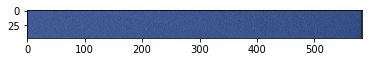

65


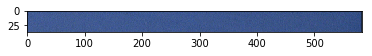

66


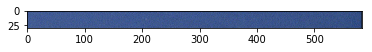

67


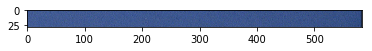

68


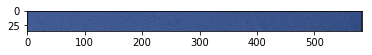

69


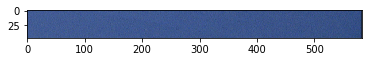

70


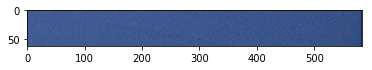

71


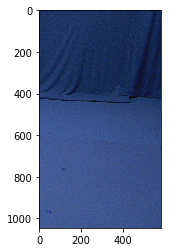

72


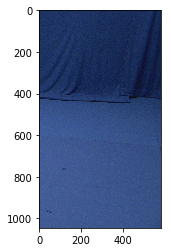

73


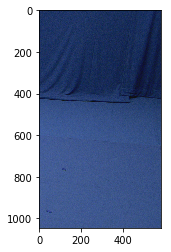

74


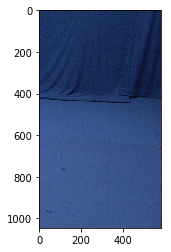

75


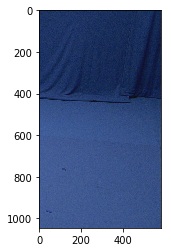

76


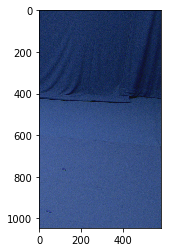

77


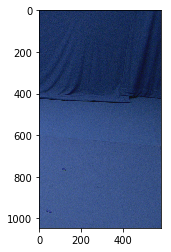

78


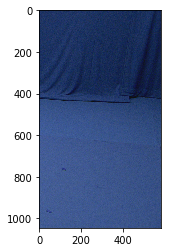

79


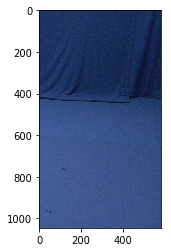

80


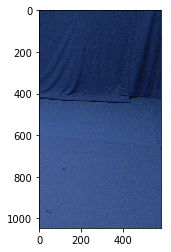

81
82
83
84
85
86
87
88
89
90
91
92
93
94
95
96
97
98
99


KeyboardInterrupt: 

In [13]:
path = "F:\dataset(cleaned)"
#'Run\Man3\D1-042.tar\D1-042\Jon\GR-jon\\042\\000\\*.png'
# 'Bend\Man5\D2-044.tar\D2-044\Hansung\GR-Hansung\044\004\\*.png'
for i in range(1,2):
    image_list = []
    file = r'''Run\Man6\D2-030.tar\D2-030\Joe\GR-Joe\030\00''' +str(i)+'''\\*.png'''
    file1 = os.path.split(file)[0]
    fname = os.path.split(file1)[1]
    f_path = os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(file1))))))
    #distutils.dir_util.mkpath(path+"/"+f_path+"/"+fname)
    mypath = path+"/"+f_path+"/"+fname
    if not os.path.isdir(mypath):
        os.makedirs(mypath)
    dir_path = path+"/"+f_path+"/"+fname
    for filename in glob.glob(file): 
        #print(filename)
        #im=Image.open(filename)
        image_list.append(filename)
    kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE,(6,6))
    for i in  range(0,len(image_list)):
    
        frame = image_list[i]
        frame = cv2.imread(frame)
        hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
        lower_green = np.array([70,113,40])
        upper_green = np.array([255, 255, 255])
        mask = cv2.inRange(hsv, lower_green, upper_green)
        fg = cv2.bitwise_and(frame, frame, mask=255-mask)

        fg = cv2.cvtColor(fg.copy(),cv2.COLOR_HSV2BGR)
        fg = cv2.cvtColor(fg,cv2.COLOR_BGR2GRAY)
   
        se = np.ones((3,3),np.uint8)
        ##fg = cv2.dilate(fg, kernel = se , iterations = 3)
        fg = cv2.threshold(fg, 25, 255, cv2.THRESH_BINARY)[1]
    
        #plt.imshow(fg)
        #plt.show()
    
        img = frame.copy()
        ret, threshed_img = cv2.threshold(fg,
                        0, 255, cv2.THRESH_BINARY)
        threshed_img = cv2.dilate(threshed_img, kernel = se , iterations = 8)
        image, contours, hier = cv2.findContours(threshed_img, cv2.RETR_EXTERNAL,cv2.CHAIN_APPROX_NONE)
        print(i)

        for cnt in contours:
            #print(cv2.contourArea(cnt))
            if cv2.contourArea(cnt) > 30000:
                # get convex hull
                hull = cv2.convexHull(cnt)
                #cv2.drawContours(img, [hull], -1, (0, 0, 255), 1)
                #print(hull)
                (x,y,w,h) = cv2.boundingRect(cnt)
                #cv2.rectangle(img, (x,y), (x+w,y+h), (255, 0, 0), 2)
                contours = hull
                #c1 = max(contours, key=cv2.contourArea)
                hull = cv2.convexHull(cnt)
                c = hull
                #print(c)
                cv2.drawContours(img, [hull], -1, (0, 0, 255), 1)
                # determine the most extreme points along the contour
                extLeft = tuple(c[c[:, :, 0].argmin()][0])
                extRight = tuple(c[c[:, :, 0].argmax()][0])
                extTop = tuple(c[c[:, :, 1].argmin()][0])
                extBot = tuple(c[c[:, :, 1].argmax()][0])
    
                cv2.drawContours(img, [c], -1, (0, 255, 255), 2)
                cv2.circle(img, extLeft, 8, (0, 0, 255), -1)
                cv2.circle(img, extRight, 8, (0, 255, 0), -1)
                cv2.circle(img, extTop, 8, (255, 0, 0), -1)
                cv2.circle(img, extBot, 8, (255, 255, 0), -1)
            
                lx = extLeft[1]
                ly = extLeft[0]
                rx = extRight[1]
                ry = extRight[0]
                tx = extTop[1]
                ty = extTop[0]
                bx = extBot[1]
                by = extBot[0]
  
                x,y = lx,by
                w,h = abs(rx-lx),abs(ty-by)

                font = cv2.FONT_HERSHEY_SIMPLEX
                cv2.putText(img,str(extLeft[0])+','+str(extLeft[1]),(extLeft), font, 2,(0, 0, 255),2,cv2.LINE_AA)
                cv2.putText(img,str(extRight[0])+','+str(extRight[1]),(extRight), font, 2,(0, 255, 0),2,cv2.LINE_AA)
                cv2.putText(img,str(extTop[0])+','+str(extTop[1]),(extTop), font, 2,(255, 0, 0),2,cv2.LINE_AA)
                cv2.putText(img,str(extBot[0])+','+str(extBot[1]),(extBot), font, 2,(255, 255, 0),2,cv2.LINE_AA)
                fy,fx,_ = frame.shape

                im = frame[tx:bx,ly:ry,:]
                cx = int(im.shape[1]//2)
                cy = int(im.shape[0]//2)
                #print(cx,cy)
                cfx,cfy = int(ly+cx),int(tx+cy)
                #print(lx,ty)
                #cv2.circle(im, (cx,cy), 15, (0, 255, 0))
                wdt = int(cfx -cy)
                extremeX = int(cfx + cy)
                #print("yr:",wdt,extremeX)
                #cv2.circle(frame, (ly+cx,tx+cy), 8, (255, 0, 255), -1)
                if i ==0:
                    tx1 = tx
                    bx1 = bx
                    wdt1 = wdt
                    extremeX1 = extremeX
                    print(tx,':',bx,',',wdt,':',extremeX)
                    #tx: 82 , bx: 801  wdt: 601  extremeX: 1319
                crop  = frame[tx1-tx : bx1 , wdt1 : extremeX1]
                crop = cv2.cvtColor(crop, cv2.COLOR_BGR2RGB)
                cv2.imwrite(os.path.join(dir_path , str(i)+'.png'), cv2.cvtColor(crop, cv2.COLOR_BGR2RGB))
                cv2.waitKey(0)
                plt.imshow(crop)
                plt.show()
    

In [2]:
#'Run\Man3\D1-042.tar\D1-042\Jon\GR-jon\\042\\000\\*.png'
# 'Run\Man1\D1-003.tar\D1-003\Nikos\Greece\\003\\000\\*.png'

file = r'''Jump\Man1\D1-004.tar\D1-004\Nikos\Greece\004\000\\*.png'''
#background = 'Back-D1\Background1\Greece\Back1\\007\\00000.png'
#image_list.append(background)
#im = Image.open('Run\Man2\D1-029.tar\D1-029\Chris\GR-Chris\\029\\001\\00022.png')
path = "F:\dataset(cleaned)"
# (\Run\Man3\\000\\)
for filename in glob.glob(file): 
    #print(filename)
    #im=Image.open(filename)
    image_list.append(filename)

In [3]:
file1 = os.path.split(file)[0]
fname = os.path.split(file1)[1]
f_path = os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(os.path.dirname(file1))))))
#distutils.dir_util.mkpath(path+"/"+f_path+"/"+fname)
mypath = path+"/"+f_path+"/"+fname
if not os.path.isdir(mypath):
    os.makedirs(mypath)
dir_path = path+"/"+f_path+"/"+fname


In [4]:
print(dir_path)

F:\dataset(cleaned)/Jump\Man1/000


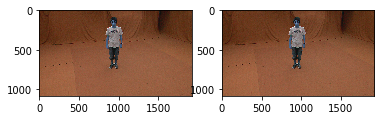

In [448]:
first = cv2.imread(image_list[0])
second = cv2.imread(image_list[1])
plt.subplot(1,2,1)
plt.imshow(first)

plt.subplot(1,2,2)
plt.imshow(second)
plt.show()

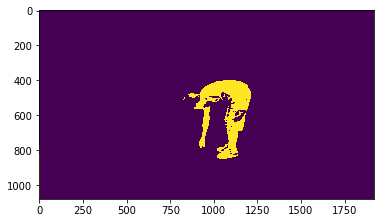

In [412]:
    frame = image_list[60]
    frame = cv2.imread(frame)
    hsv = cv2.cvtColor(frame, cv2.COLOR_BGR2HSV)
    #lower_green = np.array([0,53,50])
    #upper_green = np.array([255,215, 210])  
    lower_green = np.array([90,93,40])
    upper_green = np.array([255, 255, 255])
    #lower_green = np.array([20,0,50])
    #upper_green = np.array([255,205, 200])    #lower_green = np.array([70,103,40]) #upper_green = np.array([255,255, 255])
    mask = cv2.inRange(hsv, lower_green, upper_green)
    fg = cv2.bitwise_and(frame, frame, mask=255-mask)

    fg = cv2.cvtColor(fg.copy(),cv2.COLOR_HSV2BGR)
    fg = cv2.cvtColor(fg,cv2.COLOR_BGR2GRAY)
    fg = cv2.morphologyEx(fg.copy(), cv2.MORPH_CLOSE, kernel)
    #fg = cv2.morphologyEx(fg, cv2.MORPH_OPEN, cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (24,24)))
    se = np.ones((3,3),np.uint8)
    ##fg = cv2.dilate(fg, kernel = se , iterations = 3)
    fg = cv2.threshold(fg, 33,255, cv2.THRESH_BINARY)[1]
    
    plt.imshow(fg)
    plt.show()


In [206]:
flowX = np.dstack((cv2.imread(image_list[0]),cv2.imread(image_list[1]),cv2.imread(image_list[2]),cv2.imread(image_list[3]),cv2.imread(image_list[4]),cv2.imread(image_list[5]),cv2.imread(image_list[6]),cv2.imread(image_list[7]),cv2.imread(image_list[8]),cv2.imread(image_list[9])))
#inp = np.expand_dims(flowX, axis=0)
print(inp.shape)
#plt.imshow(inp)
#plt.show()

(1, 1080, 1920, 30)


In [237]:
def stack_optical_flow(frames, mean_sub=False):
    if frames.dtype != np.float32:
        frames = frames.astype(np.float32)
        warnings.warn('Warning! The data type has been changed to np.float32 for graylevel conversion...')
    frame_shape = frames.shape[1:-1]  # e.g. frames.shape is (10, 216, 216, 3)
    num_sequences = frames.shape[0]
    output_shape = frame_shape + (2 * (num_sequences - 1),)  # stacked_optical_flow.shape is (216, 216, 18)
    flows = np.ndarray(shape=output_shape)

    for i in range(num_sequences - 1):
        prev_frame = frames[i]
        next_frame = frames[i + 1]
        prev_gray = cv2.cvtColor(prev_frame, cv2.COLOR_BGR2GRAY)
        next_gray = cv2.cvtColor(next_frame, cv2.COLOR_BGR2GRAY)
        flow = _calc_optical_flow(prev_gray, next_gray)
        flows[:, :, 2 * i:2 * i + 2] = flow

    if mean_sub:
        flows_x = flows[:, :, 0:2 * (num_sequences - 1):2]
        flows_y = flows[:, :, 1:2 * (num_sequences - 1):2]
        mean_x = np.mean(flows_x, axis=2)
        mean_y = np.mean(flows_y, axis=2)
        for i in range(2 * (num_sequences - 1)):
            flows[:, :, i] = flows[:, :, i] - mean_x if i % 2 == 0 else flows[:, :, i] - mean_y

    return flows


def _calc_optical_flow(prev, next_):
    flow = cv2.calcOpticalFlowFarneback(prev, next_, flow=None, pyr_scale=0.5, levels=3, winsize=15, iterations=3,
                                        poly_n=5, poly_sigma=1.2, flags=0)
    return flow


y


In [247]:
frames = np.load(file_dir)
# note: store the final processed data with type of float16 to save storage
processed_data = stack_optical_flow(frames, mean_sub).astype(np.float16)


PermissionError: [Errno 13] Permission denied: 'dataset(cleaned)\\Run\\Man2\\000'

In [245]:
os.chdir('F:')

In [246]:
file_dir = r'''dataset(cleaned)\Run\Man2\000'''